In [3]:
library('ggplot2')
library('reshape2')
library('ggpubr')
library(glmnet)
library(doMC)
library(survival)
library(data.table)
library(mltools)
library(CoxBoost)
library(randomForestSRC)
library(CoxHD)
library(Hmisc)
library(gridExtra)
library("survminer")
library(dplyr)
library(stringr)

source("../../../../src/tools.R")
options(repr.plot.res        = 100, # set a medium-definition resolution for the jupyter notebooks plots (DPI)
        repr.matrix.max.rows = 250, # set the maximum number of rows displayed
        repr.matrix.max.cols = 250) # set the maximum number of columns displayed

In [4]:
df_reshuffling <- NULL
for (l in list.files('../Reshuffling_final')){
    if (grepl("_reshuffle_importance.tsv",l)){
        df_tmp <- read.table(paste('../Reshuffling_final/',l,sep=""))
        df_tmp$Ratio <- df_tmp$ref_CI/df_tmp$permuted_CI
        df_tmp <- df_tmp[,c("feature","Ratio","algo","model")]
        df_reshuffling <- rbind(df_reshuffling,df_tmp)     
    }
}

df_bootstrap <- NULL
for (l in list.files('../Bootstrap_coef_final/')){
    if (grepl("_bootstrap",l)){
        if(grepl("_bootstrap_SVM",l)){
            df_tmp <- read.table(paste('../Bootstrap_coef_final/',l,sep=""),sep=',',header=T)
            df_tmp <- df_tmp[,-1]
            df_tmp <- df_tmp[,c(2,1,3)]
        } else {
            df_tmp <- read.table(paste('../Bootstrap_coef_final/',l,sep=""))
        }
        colnames(df_tmp) <- c("feature","sum_coef","num_selected")
        df_tmp$model_algo <- str_sub(l, 1, str_length(l)-4)
        df_bootstrap <- rbind(df_bootstrap,df_tmp)   
    }
}
df_bootstrap <- df_bootstrap[df_bootstrap$feature!="age.1" & !is.na(df_bootstrap$feature),]
df_bootstrap$model <- sub("_bootstrap_.*$", "", df_bootstrap$model_algo )

dim(df_reshuffling)
dim(df_bootstrap)

[1] 955200      4

[1] 9455    5

In [5]:
df_final <- read.table("../../../clustering/clustering_Final_1/df_final_full_component.tsv")
eln <- colnames(df_final[,c(2,3,4)])
comp <- colnames(df_final[,c(170:186)])

all_gen <- c(5:88)
vect <- apply(X=df_final[,all_gen],2,FUN=function(x) 100*length(which(x==1))/dim(df_final)[1])
gen <- colnames(df_final[,match(names(vect[vect>=2]),names(df_final))])
              
all_cyto <- c(89:158)
vect <- apply(X=df_final[,all_cyto],2,FUN=function(x) 100*length(which(x==1))/dim(df_final)[1])
cyto <- colnames(df_final[,match(names(vect[vect>=2]),names(df_final))])
              
clin <- colnames(df_final[,c(159:165)])
demo <- colnames(df_final[,c(166:167)])

              
pal <- c(eln="#EE9937",comp="#59A08B",gen="#BFBFBF",cyto="#2b8cbe",clin="#870C14",demo="#a6bddb")  


In [10]:
# Function showing Feature Importance for the Models



importance <- function (models=unique(df_reshuffling$model),fun=median){
    for (model in models){
        set_notebook_plot_size(25,40)
        #Resuflling Importance

        feature_model <- df_reshuffling[df_reshuffling$model==model ,] 
        #%>% filter(str_detect(model, c("0.7|0|1|boost|rfs")))

        feature_model <- feature_model[,c('feature','Ratio','algo')] %>% group_by(feature,algo)  
        #%>% summarize_all(sum)

        feature_model$category <- ifelse(is.element(feature_model$feature,eln),"eln",
                                       ifelse(is.element(feature_model$feature,comp),"comp",
                                             ifelse(is.element(feature_model$feature,gen),"gen",
                                                   ifelse(is.element(feature_model$feature,cyto),"cyto",
                                                         ifelse(is.element(feature_model$feature,clin),"clin","demo")))))

        feature_model$algo <- toupper(feature_model$algo)
        #feature_model$algo <- ifelse(feature_model$algo=="COX","SIMPLE_COX",feature_model$algo)

        # Bootstrapping + Coef Importance

        p <- ggplot(na.omit(feature_model),aes(x=reorder(feature,Ratio,FUN=fun),y=Ratio,fill=category))+geom_boxplot()+facet_wrap(~algo,ncol=6)+
        theme(plot.title = element_text( size=30, face="bold.italic",hjust=0.5),legend.text=element_text(size=10),legend.position="top",
          axis.text.x = element_text(angle = 90, hjust = 0.8,vjust=0.8,size=12),axis.text.y=element_text(size=12),
          axis.title.y = element_text(size = 20),axis.title.x = element_text(size = 20),strip.text = element_text(size=25))+xlab("Selected Features") +
        ylab("Ratio (ref_CI/Permuted_CI) ") + ggtitle(paste(model, "Model Feature importance Reshuffling"))+coord_flip() +scale_fill_manual(values=pal,limits=names(pal))


        feature_model <- df_bootstrap[startsWith(df_bootstrap$model_algo,paste(model,"_bootstrap_",sep="")) ,] %>% filter(str_detect(model_algo, c("0.7|0|1|boost|rfs|rfx")))

        feature_model <- feature_model[,c('feature','sum_coef','num_selected','model_algo')] %>% group_by(feature,model_algo)  
        #%>% summarize_all(sum)

        feature_model$category <- ifelse(is.element(feature_model$feature,eln),"eln",
                                       ifelse(is.element(feature_model$feature,comp),"comp",
                                             ifelse(is.element(feature_model$feature,gen),"gen",
                                                   ifelse(is.element(feature_model$feature,cyto),"cyto",
                                                         ifelse(is.element(feature_model$feature,clin),"clin","demo")))))

        feature_model$model_algo <- toupper(gsub(".*_bootstrap_", "",feature_model$model_algo ))
        feature_model$model_algo <- ifelse(feature_model$model_algo=="GLM_0","RIDGE",
                                          ifelse(feature_model$model_algo=="GLM_0.7","ELASTIC_NET",
                                                ifelse(feature_model$model_algo=="GLM_1","LASSO",feature_model$model_algo)))

        q <- ggplot(na.omit(feature_model %>% filter(str_detect(model_algo, c("LASSO|RIDGE|ELASTIC_NET|BOOST|RFS|RFX")))),aes(x=reorder(feature,num_selected,FUN=mean),y=num_selected,fill=category))+geom_bar(stat = "identity")+facet_wrap(~model_algo,ncol=6)+
        theme(plot.title = element_text( size=30, face="bold.italic",hjust=0.5),legend.text=element_text(size=10),legend.position="top",
          axis.text.x = element_text(angle = 90, hjust = 0.8,vjust=0.8,size=12),axis.text.y=element_text(size=12),
          axis.title.y = element_text(size = 20),axis.title.x = element_text(size = 20),strip.text = element_text(size=25))+xlab("Selected Features") +
        ylab("Proportion of selection count overall models and algorithms ") + ggtitle(paste(model, "Model Feature importance Bootstrap for Algorithms"))+coord_flip() +scale_fill_manual(values=pal,limits=names(pal))

        r <-  ggplot(na.omit(feature_model %>% filter(str_detect(model_algo, c("LASSO|RIDGE|ELASTIC_NET")))),aes(x=reorder(feature,sum_coef),y=sum_coef,fill=category))+geom_bar(stat = "identity")+facet_wrap(~model_algo,ncol=5)+
        theme(plot.title = element_text( size=30, face="bold.italic",hjust=0.5),legend.text=element_text(size=10),legend.position="top",
          axis.text.x = element_text(angle = 90, hjust = 0.8,vjust=0.8,size=12),axis.text.y=element_text(size=12),
          axis.title.y = element_text(size = 20),axis.title.x = element_text(size = 20),strip.text = element_text(size=25))+xlab("Selected Features") +
        ylab("Sum of coefficients over GLM Models ") + ggtitle(paste(model, "Coefficients for Cox Penalized Models"))+coord_flip() +scale_fill_manual(values=pal,limits=names(pal))

#         grid.arrange(p,q,r,nrow=3)
        grid.arrange(p,nrow=1)


    }
}

# IMPACT OF GENES (SRSF2 AND TET2) ON AGE

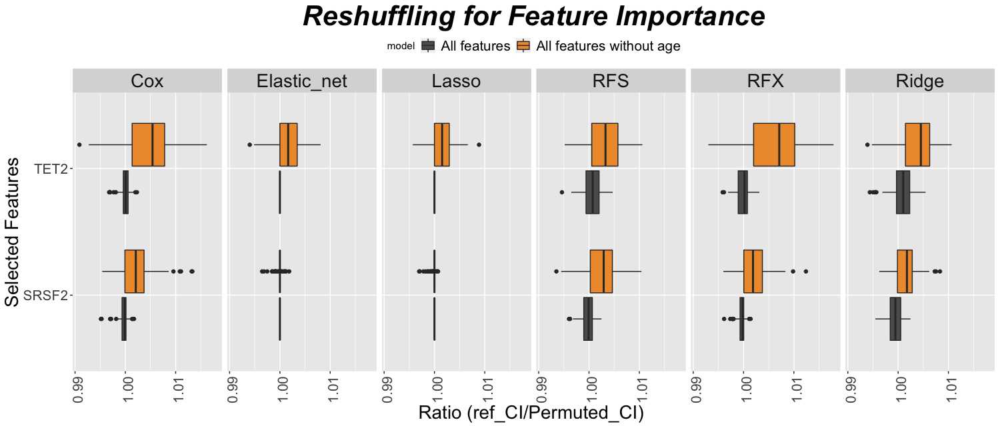

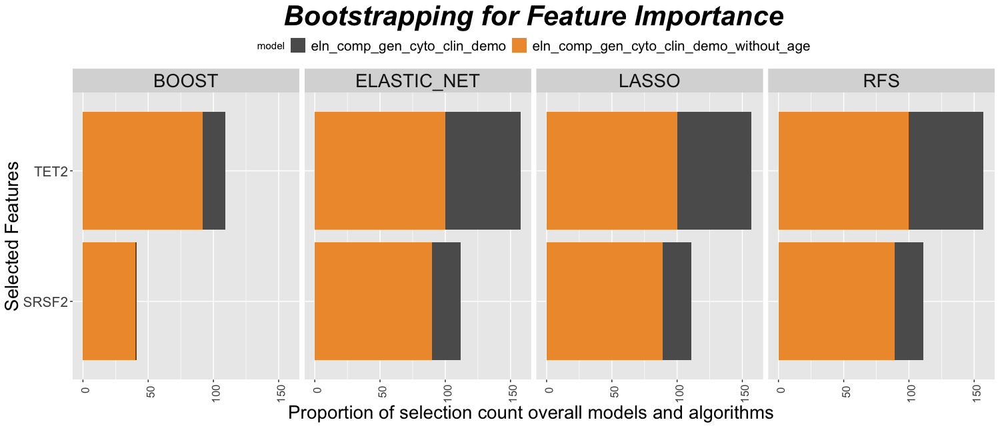

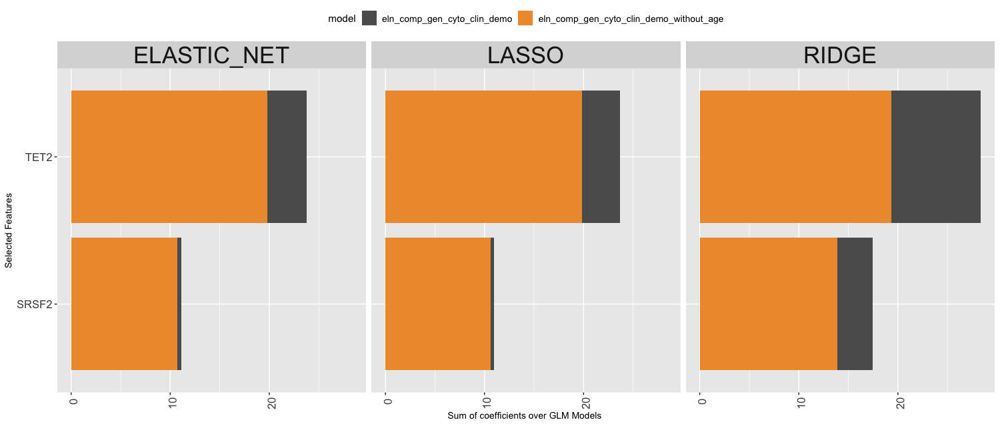

In [35]:
models = c("eln_comp_gen_cyto_clin_demo","eln_comp_gen_cyto_clin_demo_without_age")
set_notebook_plot_size(15,6.4)
feature_model <- NULL
feature_model <- df_reshuffling[is.element(df_reshuffling$model,models),]
feature_model <- feature_model[is.element(feature_model$feature,c("SRSF2","TET2")),]
feature_model <- feature_model[,c('feature','Ratio','algo','model')] %>% group_by(feature,algo,model) 
feature_model$model <- ifelse(feature_model$model=="eln_comp_gen_cyto_clin_demo","All features","All features without age")
ggplot(na.omit(feature_model),aes(x=reorder(feature,Ratio,FUN=median),y=Ratio,fill=model))+geom_boxplot()+facet_wrap(~algo,ncol=6)+
        theme(plot.title = element_text( size=30, face="bold.italic",hjust=0.5),legend.text=element_text(size=15),legend.position="top",
          axis.text.x = element_text(angle = 90, hjust = 0.8,vjust=0.8,size=15),axis.text.y=element_text(size=15),
          axis.title.y = element_text(size = 20),axis.title.x = element_text(size = 20),strip.text = element_text(size=20))+xlab("Selected Features") +
        ylab("Ratio (ref_CI/Permuted_CI) ") + ggtitle("Reshuffling for Feature Importance")+coord_flip() +scale_fill_manual(values=c("#5C5C5C","#EE9937"))

feature_model <- NULL
feature_model <- df_bootstrap[startsWith(df_bootstrap$model_algo,"eln_comp_gen_cyto_clin_demo_bootstrap_") | startsWith(df_bootstrap$model_algo,"eln_comp_gen_cyto_clin_demo_without_age_bootstrap_") ,] %>% filter(str_detect(model_algo, c("0.7|0|1|boost|rfs|rfx")))
feature_model <- feature_model[is.element(feature_model$feature,c("SRSF2","TET2")),]
feature_model$model_algo <- toupper(gsub(".*_bootstrap_", "",feature_model$model_algo ))
feature_model$model_algo <- ifelse(feature_model$model_algo=="GLM_0","RIDGE",
                                  ifelse(feature_model$model_algo=="GLM_0.7","ELASTIC_NET",
                                        ifelse(feature_model$model_algo=="GLM_1","LASSO",feature_model$model_algo)))
ggplot(na.omit(feature_model %>% filter(str_detect(model_algo, c("LASSO|ELASTIC_NET|BOOST|RFS")))),aes(x=reorder(feature,num_selected,FUN=mean),y=num_selected,fill=model))+geom_bar(stat = "identity")+facet_wrap(~model_algo,ncol=6)+
        theme(plot.title = element_text( size=30, face="bold.italic",hjust=0.5),legend.text=element_text(size=15),legend.position="top",
          axis.text.x = element_text(angle = 90, hjust = 0.8,vjust=0.8,size=12),axis.text.y=element_text(size=15),
          axis.title.y = element_text(size =20),axis.title.x = element_text(size = 20),strip.text = element_text(size=20))+xlab("Selected Features") +
        ylab("Proportion of selection count overall models and algorithms ") + ggtitle("Bootstrapping for Feature Importance") +coord_flip() +scale_fill_manual(values=c("#5C5C5C","#EE9937"))

ggplot(na.omit(feature_model %>% filter(str_detect(model_algo, c("LASSO|RIDGE|ELASTIC_NET")))),aes(x=reorder(feature,sum_coef),y=sum_coef,fill=model))+geom_bar(stat = "identity")+facet_wrap(~model_algo,ncol=5)+
theme(plot.title = element_text( size=10, face="bold.italic",hjust=0.5),legend.text=element_text(size=10),legend.position="top",
  axis.text.x = element_text(angle = 90, hjust = 0.8,vjust=0.8,size=12),axis.text.y=element_text(size=12),
  axis.title.y = element_text(size = 10),axis.title.x = element_text(size = 10),strip.text = element_text(size=25))+xlab("Selected Features") +
ylab("Sum of coefficients over GLM Models ") + coord_flip() +scale_fill_manual(values=c("#5C5C5C","#EE9937"))


# SELECTED MODELS

In [51]:
png("../../../script_figures/gen_cyto_old.png",width=5000,height=5000,res=250)
importance(models = c("gen_cyto"))
dev.off()

pdf 
  2

In [50]:
png("../../../script_figures/cyto_old.png",width=5000,height=5000,res=250)
importance(models = c("cyto"))
dev.off()

pdf 
  2

In [48]:
png("../../../script_figures/gen_old.png",width=5000,height=5000,res=250)
importance(models = c("gen"))
dev.off()

pdf 
  2

In [49]:
png("../../../script_figures/comp_old.png",width=5000,height=5000,res=250)
importance(models = c("comp"))
dev.off()

pdf 
  2

In [46]:
png("../../../script_figures/comp_gen_cyto_old.png",width=5000,height=5000,res=250)
importance(models = c("comp_gen_cyto"))
dev.off()

pdf 
  2

In [58]:
png("../../../script_figures/comp_gen_cyto_clin_demo_old.png",width=5000,height=5000,res=250)
importance(models = c("comp_gen_cyto_clin_demo"))
dev.off()

pdf 
  2

# Selected Models

# All Models

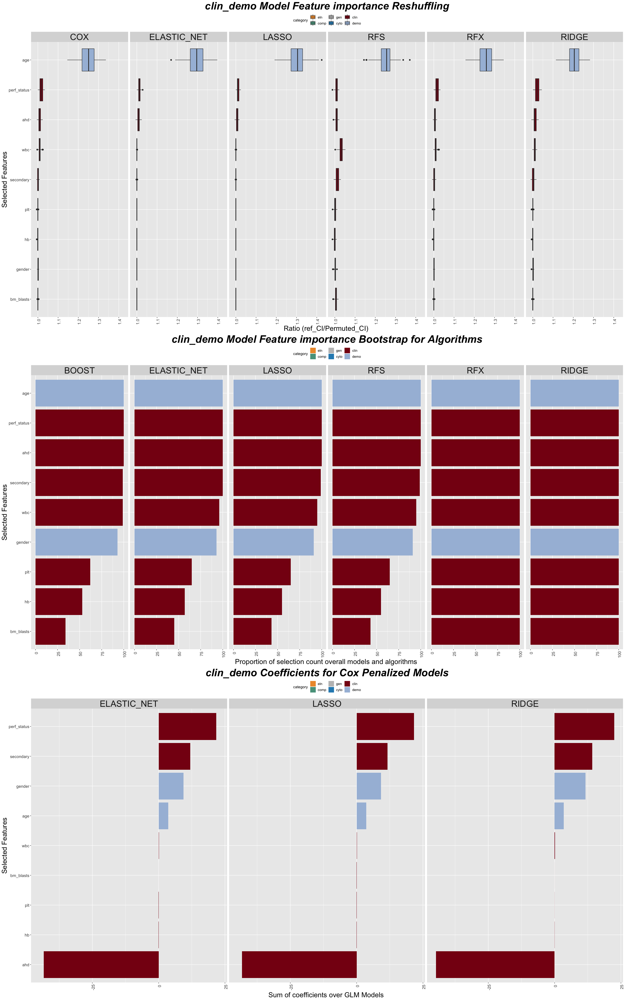

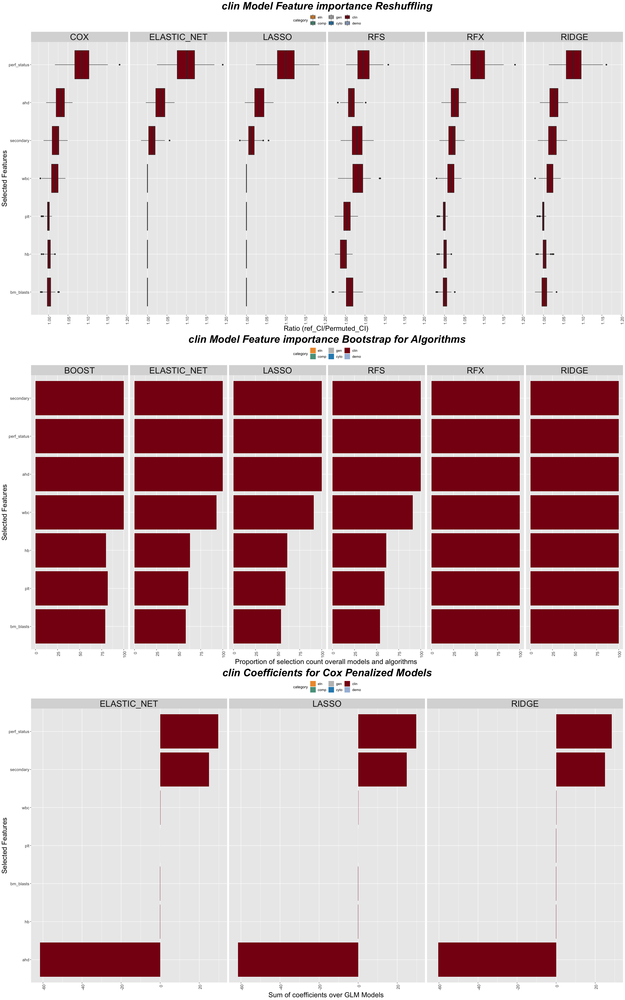

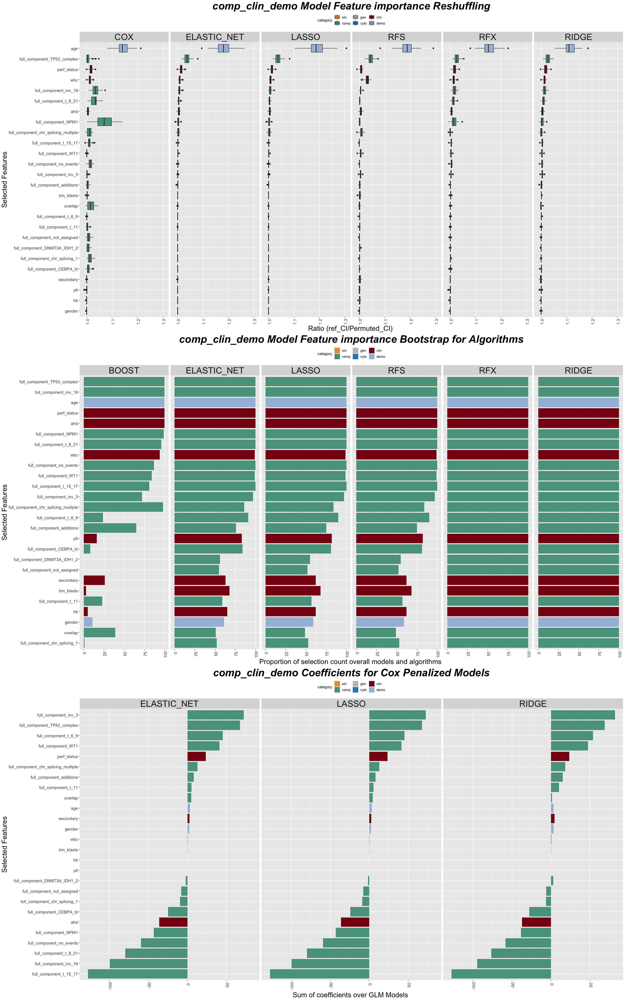

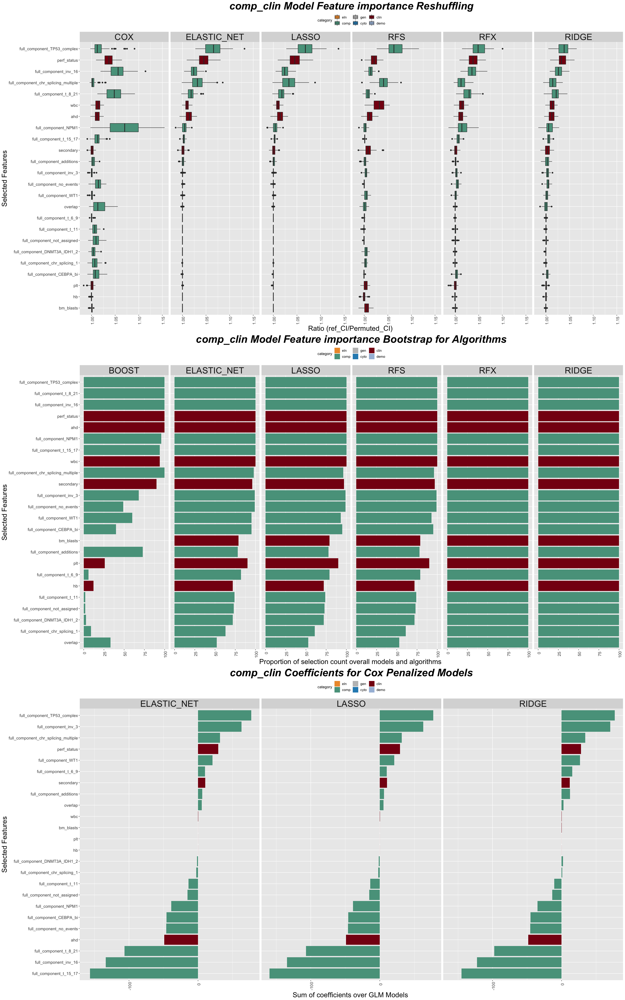

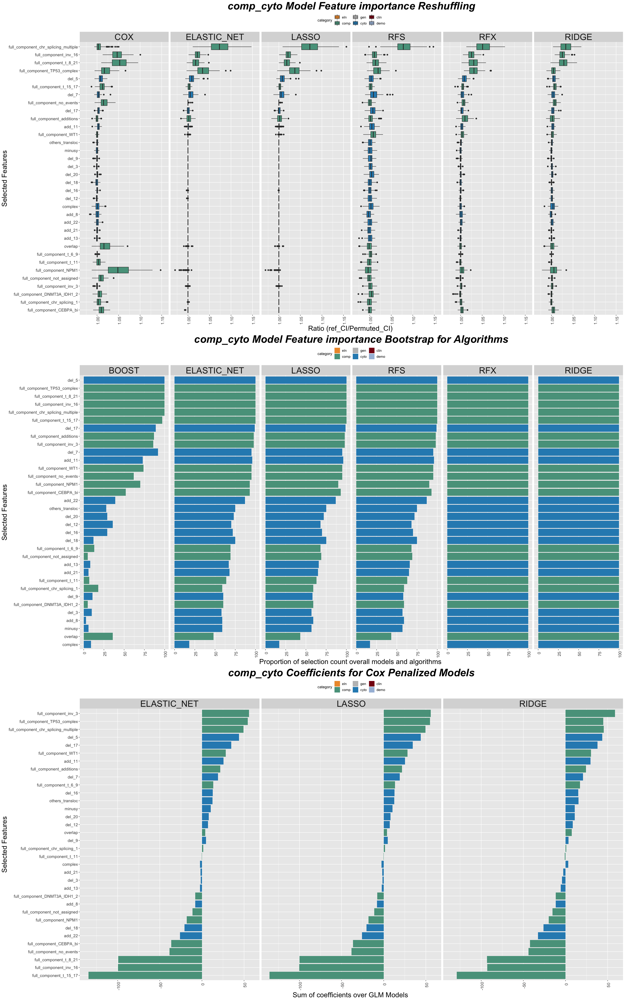

...

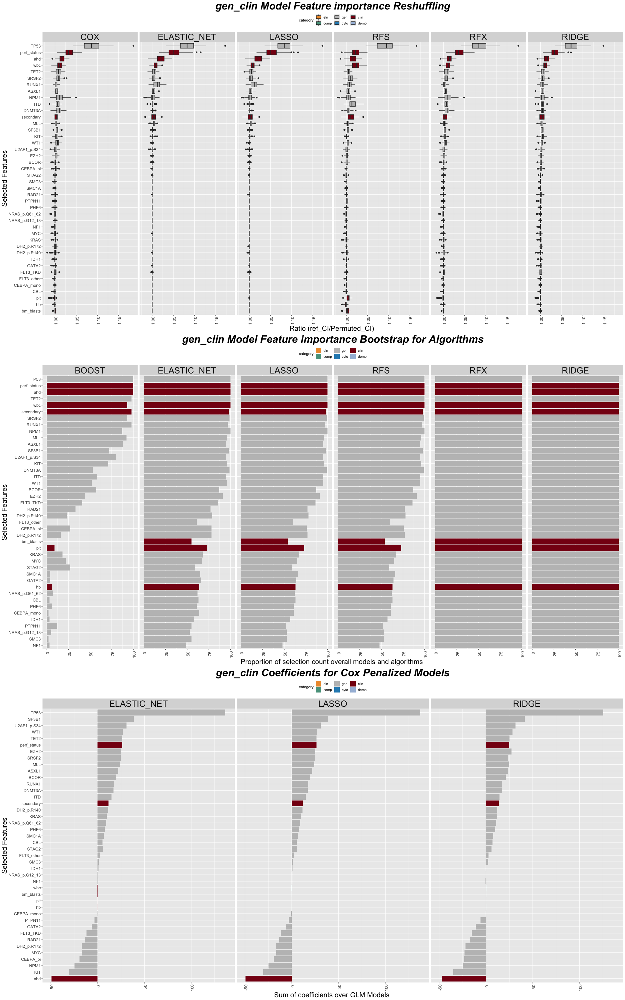

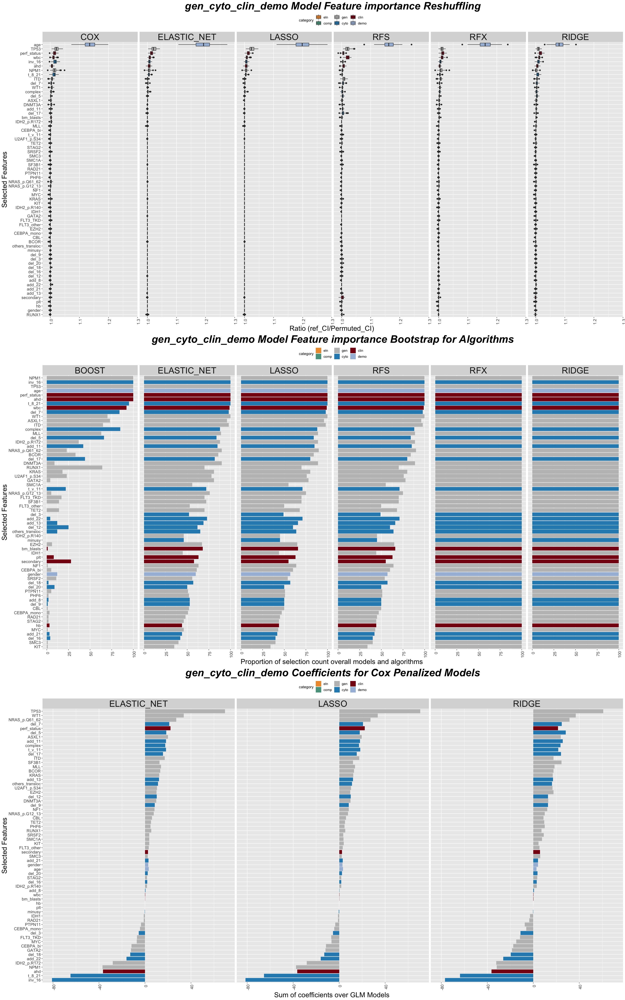

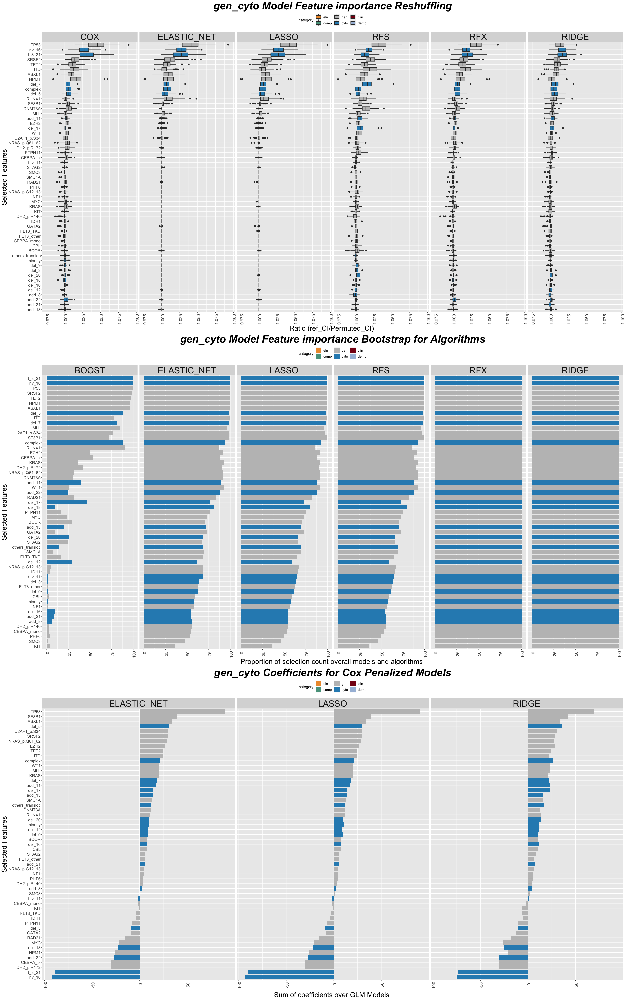

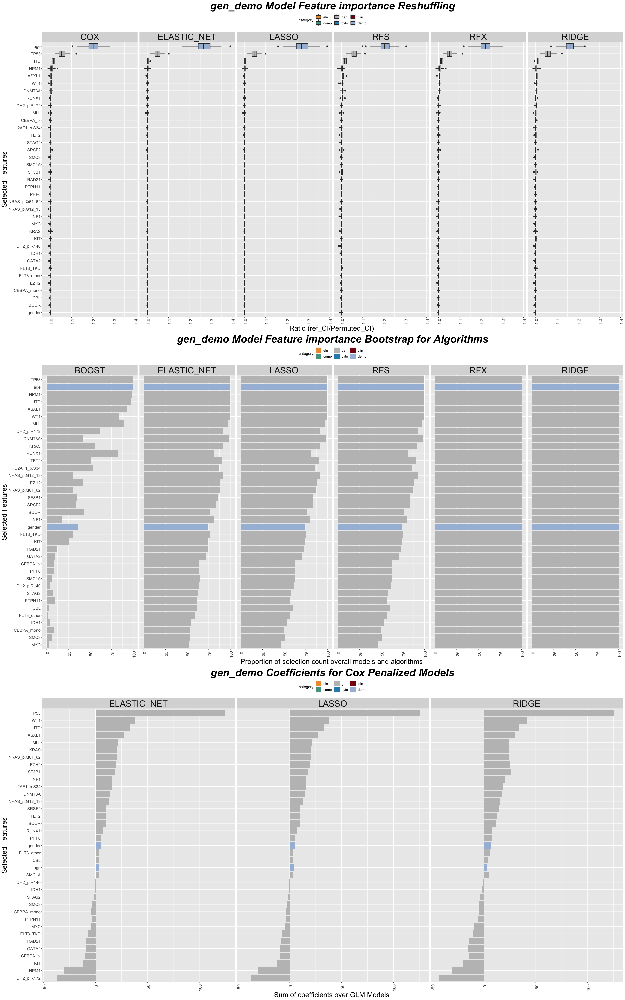

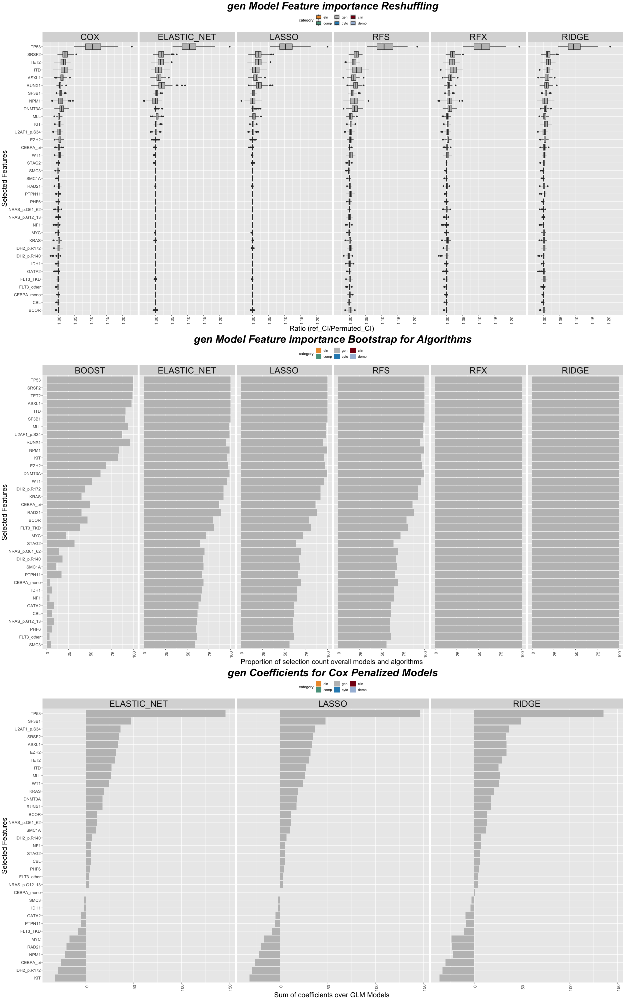

In [8]:
importance()